<a href="https://colab.research.google.com/github/d3ath-add3r/Crops_Image_Classifcation/blob/main/Crop_Classification_ANN%26CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<table align="center" width=100%>
    <tr>
        <td width = 20%>
            <img src=https://drive.google.com/uc?export=view&id=1WuoQW_fABqFlEsQXE_RxjIC9ZSR6f4Gh>
        </td>
        <th>
        <div align="center">
        <font face = "Garamond" size = "10" color="Cyan">Classification of Crops Using ANN</font>
        </div>
        </th>
    </tr>
</table>
<font face = "Arial" size = "4" color="white" >
<br>
        &emsp;&emsp;&emsp;Worldwide there are varieties of crops cultivated over ages. Each variety has its own distinguishing features over a broad spectrum of height, color, structure, number of seeds, etc. In taxonomy, there are various species, types of crops. The crops can be classified in various ways. Appearance is the first thing that will help in classification. Crops need to be identified as each crop needs specific treatment. We will try to use <b>Artificial Neural Networks(ANN)</b> to identify crops from images of different crops.
        <br>
        <br>
        &emsp;&emsp;&emsp;The dataset has images of following crops:
</font>
<table align="center" width=100% >
    <tr>
        <td width = 20%>
            <img src=https://drive.google.com/uc?export=view&id=1R6nM-VSBKoQDBTdFANjJv6JK73BBlJqz>
        </td>
        <td width = 20%>
            <img src=https://drive.google.com/uc?export=view&id=1sbN7guuQ7BxsjL3RId4EDvc0IOxsbJq9>
        </td>
        <td width = 20%>
            <img src=https://drive.google.com/uc?export=view&id=1AqzqJh9v2O7bP7oXLnfYuKXWHO-iMo3m>
        </td>
        <td width = 20%>
            <img src=https://drive.google.com/uc?export=view&id=1WBJv61P_RLghAmXCXEkjOcLTFUdAYM0e>
        </td>
        <td width = 20%>
            <img src=https://drive.google.com/uc?export=view&id=1uyJ6t9cYsE3GhT0l5yqtq_AKmC9gaGzZ>
        </td>
    </tr>
    <tr>
        <td width = 20% height = "20">
            <div align="center">
            <font face = "Georgia" size = "5" color="Yellow"><b>1. Jute</b></font>
            </div>
            </td>
        <td width = 20% height = "20">
            <div align="center">
            <font face = "Georgia" size = "5" color="Yellow"><b>2. Maize</b></font>
            </div>
            </td>
            <td width = 20% height = "20">
            <div align="center">
            <font face = "Georgia" size = "5" color="Yellow"><b>3. Rice</b></font>
            </div>
            </td>
            <td width = 20% height = "20">
            <div align="center">
            <font face = "Georgia" size = "5" color="Yellow"><b>4. Sugarcane</b></font>
            </div>
            </td>
            <td width = 20% height = "20">
            <div align="center">
            <font face = "Georgia" size = "5" color="Yellow"><b>5. Wheat</b></font>
            </div>
            </td>
    </tr>
</table>


# Objective : To build an ANN Classifier to identify Crops.

## Importing required libraries and packages

In [ ]:
# We will check installed version of tensorflow, if it is not 2.0.0, we will install the same
# Importing Tensorflow and checking the version
import tensorflow as tf
print(tf.__version__)

2.7.0


In [ ]:
# As the installed version is 2.7.0 we will install 2.0.0
!pip install tensorflow==2.0.0

#Restart the runtime

In [ ]:
import tensorflow as tf
print(tf.__version__) # the version must now be 2.0.0

2.0.0


In [ ]:
# Importing all the packages and libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.regularizers import l1,l2,l1_l2

from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Flatten
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import img_to_array


from imutils import paths
import random
import pickle
import cv2
import os
import time 
from tqdm import tqdm_notebook as tqdm
import itertools

import warnings
warnings.filterwarnings("ignore")

SEED = 51  # Set random seed

### Load the data from the drive

In [ ]:
# Mount the google drive to google colab

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Change the working directory to appropriate folder
os.chdir("/content/drive/MyDrive/PGAA08_DS_DL/Crop_Classification_ANN")

In [ ]:
# Check current directory
!dir

Crop_ANN.h5			   Crop_CNN.h5	 dataset_crop.rar  html_imgs
Crop_Classification_ANN&CNN.ipynb  dataset_crop  flagged


We can see that appropriate directory has been set and we have the required files in our directory. We will have to extract data from the compressed file.

### **Unzipping the Compressed folder.**

In [ ]:
# we will require patool to extract 
!pip install patool

In [ ]:
# Extracting dataset_crop.rar only if it has not been done previously to avoid duplication
import patoolib
files = os.listdir()  # Get all file names in the directory
a = 0
for name in files:
    if name == "dataset_crop":
        print("Folder already extracted")
        a = 1
        break
    else:
        a = 0 
    
if a==0:
    print("Extracting dataset_crop ...")
    patoolib.extract_archive("dataset_crop.rar")
    files = os.listdir()

print("Directory contains:")
!dir  # Check if extraction done

Folder already extracted
Directory contains:
Crop_ANN.h5		       dataset_crop	 html_imgs
Crop_Classification_ANN.ipynb  dataset_crop.rar


In [ ]:
os.listdir('dataset_crop') # to see contents of the folder

['test_crop_image', 'train_crop_image']

In [ ]:
list(paths.list_images('dataset_crop/train_crop_image'))[:5] # To see how paths pf images of first 5 images of train_crop_image dataset

['dataset_crop/train_crop_image/maize/maize020ahf.jpeg',
 'dataset_crop/train_crop_image/maize/maize003ahf.jpeg',
 'dataset_crop/train_crop_image/maize/maize022arot.jpeg',
 'dataset_crop/train_crop_image/maize/maize009ahs.jpeg',
 'dataset_crop/train_crop_image/maize/maize026ahf.jpeg']

In [ ]:
# imagePaths1 = sorted(list(paths.list_images('dataset_crop/train_crop_image')))
# classes_dict1 = {"jute":0,"maize":1,"rice":2,"sugarcane":3,"wheat":4}
# labels1 = []
# for imagePath in imagePaths1:
#     label1 = imagePath.split(os.path.sep)[-2]
#     label1 = classes_dict1[label1]
#     labels1.append(label1)

# print(labels1)

In [ ]:
# Initialise the data and the labels

print("[WIP] Loading Images.....")
time1 = time.time() # starting time 
data = []

labels= []

classes = ["jute","maize","rice","sugarcane","wheat"]
classes_dict = {"jute":0,"maize":1,"rice":2,"sugarcane":3,"wheat":4}

# Grab the image paths and randomly shuffle them
imagePaths = sorted(list(paths.list_images('dataset_crop/train_crop_image'))) # all the training images
random.seed(SEED)
random.shuffle(imagePaths)

# Progress Bar
with tqdm(total = len(imagePaths)) as pbar:

    # Looping over training images to process them and get the labels
    for imagePath in imagePaths:
        # load the image and resize it to 64 x 64 pixels irrespective of aspect ratio
        image = cv2.imread(imagePath)
        # flatten the  64 X 64 X 3 = 12,288 pixel image into a 1d list(array-like), and store the image pixels in data list
        image = cv2.resize(image, (64,64)).flatten()
        data.append(image)

        # Extract the label from the path and update the labels list
        label = imagePath.split(os.path.sep)[-2]
        label = classes_dict[label]
        labels.append(label)

        # Update the progress bar
        pbar.update(1)


# Scale the image pixels from range 0-255 to range 0-1
data = np.array(data, dtype="float") / 255.0
labels = np.array(labels) # Convert labels list to an array

print("Time taken to initialize : {:.1f} seconds".format(time.time() - time1)) # To measure time taken
print("Done")

[WIP] Loading Images.....


  0%|          | 0/804 [00:00<?, ?it/s]

Time taken to initialize : 319.0 seconds
Done


In [ ]:
print("Total number of images :", len(data)) # It must be 804

Total number of images : 804


In [ ]:
# sample data for first image
print("sample image: {}".format(data[0]))
print("no of features/pixels values: {}".format(len(data[0]))) # 64 X 64 X 3 = 12,288
print("label: {}".format(classes[labels[0]]))

sample image: [0.03921569 0.1254902  0.05098039 ... 0.09019608 0.2745098  0.16078431]
no of features/pixels values: 12288
label: sugarcane


## **Data Visualisation**

3 sugarcane


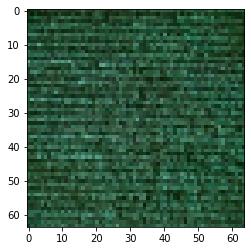

In [ ]:
# Displaying the first image
sample_img = (data[0] * 255).astype("int")
plt.imshow(sample_img.reshape(64,64,3))
print(labels[0],classes[labels[0]])

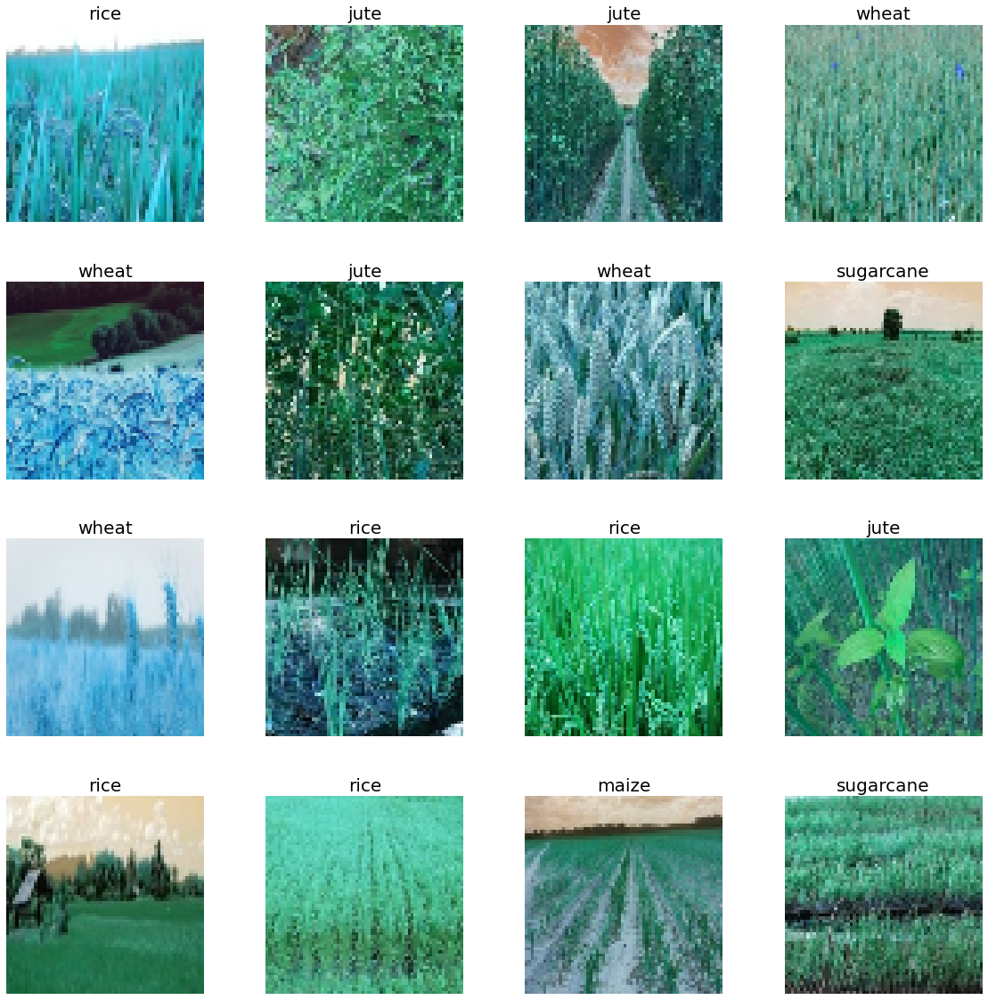

In [ ]:
# Now we will display grip of multiple images

# Set the grid dimensions
w_grid = 4 #Horizontal
h_grid = 4 #Vertical

fig, axes = plt.subplots(w_grid, h_grid, figsize = (20,20))

axes = axes.ravel() # Flatten grid area into an array

n_data = len(data) # get number of images

# select a random number from 0 to n_data
for i in np.arange(0, w_grid*h_grid) :  # Create evenly spaced variables

    #Select a random number
    index = np.random.randint(0, n_data)

    # Display the image corresponding to the random number
    axes[i].imshow(data[index].reshape(64,64,3))
    axes[i].set_title(classes[labels[index]], fontsize=20)
    axes[i].axis('off')

plt.subplots_adjust(hspace=0.3)

### Splitting the data and labels into training and validation datasets

In [ ]:
# Split the data and labels into 75% training and 25% validation
(trainX, valX, trainY, valY) = train_test_split(data, labels, test_size=0.25, random_state = SEED)

In [ ]:
trainX.shape # This is right input for the ANN with input layer of 12288 nodes. 

(603, 12288)

In [ ]:
trainY.shape

(603,)

## **Define the ANN Architecture**

---(Model)



In [ ]:
# We will define 12288-6144-1536-192-5 ANN Architecture

model = Sequential()  # This will add layer after layer in order

# Our input layer will be the image data of 12288 nodes
# First Hidden Layer with 6144 nodes
model.add(Dense(units= 6144, input_shape=(12288,), kernel_initializer = 'uniform', activation= "relu"))

# Second Hidden Layer with 1536 nodes
model.add(Dense(units= 1536, kernel_initializer = 'uniform', activation = "relu"))

# Third Hidden Layer with 192 nodes
model.add(Dense(units = 192, kernel_initializer = 'uniform', activation = "relu"))

# Output Layer with nodes equal to possible number of classes(5)
model.add(Dense(units = 5, kernel_initializer = 'uniform', activation = "softmax"))  # Softmax as it multi-class classification

## **Compile the model**

In [ ]:
# Compile the ANN model
# Set initial learning rate and number of epochs
LR_INIT = 0.01
EPOCHS = 50

# We will compile the model using SGD as optimizer and sparse categorical cross-entropy loss
print("[WIP] Compiling ANN...")

opt = SGD(learning_rate=LR_INIT) # Stochastic Gradient Descent (SGD) optimizer

model.compile(loss = "sparse_categorical_crossentropy", optimizer = opt, metrics = ["accuracy"]) # We will use sparse categorical cross-entropy for not hot encoded target

[WIP] Compiling ANN...


In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 6144)              75503616  
_________________________________________________________________
dense_5 (Dense)              (None, 1536)              9438720   
_________________________________________________________________
dense_6 (Dense)              (None, 192)               295104    
_________________________________________________________________
dense_7 (Dense)              (None, 5)                 965       
Total params: 85,238,405
Trainable params: 85,238,405
Non-trainable params: 0
_________________________________________________________________


## **Train the model on Training Data**

In [ ]:
# We will use batch size of 16 images

time1 = time.time() # starting time
H = model.fit(trainX, trainY, validation_data=(valX, valY), epochs=EPOCHS, batch_size=16)
print('Time taken : {:.1f} seconds'.format(time.time() - time1)) # to measure time taken

Train on 603 samples, validate on 201 samples
Epoch 1/50
603/603 [==============================] - 17s 28ms/sample - loss: 1.6163 - accuracy: 0.3167 - val_loss: 1.3653 - val_accuracy: 0.5075
Epoch 2/50
603/603 [==============================] - 15s 25ms/sample - loss: 1.3569 - accuracy: 0.4478 - val_loss: 1.2975 - val_accuracy: 0.4776
Epoch 3/50
603/603 [==============================] - 16s 27ms/sample - loss: 1.3189 - accuracy: 0.4710 - val_loss: 1.3805 - val_accuracy: 0.4677
Epoch 4/50
603/603 [==============================] - 15s 25ms/sample - loss: 1.0987 - accuracy: 0.5721 - val_loss: 1.3190 - val_accuracy: 0.5025
Epoch 5/50
603/603 [==============================] - 15s 25ms/sample - loss: 1.0859 - accuracy: 0.5556 - val_loss: 1.6942 - val_accuracy: 0.4279
Epoch 6/50
603/603 [==============================] - 15s 25ms/sample - loss: 1.0894 - accuracy: 0.6186 - val_loss: 1.1992 - val_accuracy: 0.4378
Epoch 7/50
603/603 [==============================] - 16s 26ms/sample - loss: 

KeyboardInterrupt: ignored

We can see our model overfitting which can be due to number of reasons. It might be due to complexity of the ANN Architecture, large number of nodes or layers.
We will try simplifying the architecture.


## **Model1**

In [ ]:
# We will define 12288-3072-768-5 ANN Architecture

model1 = Sequential()  # This will add layer after layer in order

# Our input layer will be the image data of 12288 nodes
# First Hidden Layer with 3072 nodes
model1.add(Dense(units= 3072, input_shape=(12288,), kernel_initializer = 'uniform', activation= "relu"))

# Second Hidden Layer with 768 nodes
model1.add(Dense(units= 768, kernel_initializer = 'uniform', activation = "relu"))


# Output Layer with nodes equal to possible number of classes(5)
model1.add(Dense(units = 5, kernel_initializer = 'uniform', activation = "softmax"))

In [ ]:
# Compile the new ANN model
# Set initial learning rate and number of epochs
LR_INIT = 0.01
EPOCHS = 50

# We will compile the model using SGD as optimizer and sparse categorical cross-entropy loss
print("[WIP] Compiling ANN...")

opt = SGD(learning_rate=LR_INIT) # Stochastic Gradient Descent (SGD) optimizer

model1.compile(loss = "sparse_categorical_crossentropy", optimizer = opt, metrics = ["accuracy"]) # We will use sparse categorical cross-entropy for not hot encoded target

model1.summary()

[WIP] Compiling ANN...
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_8 (Dense)              (None, 3072)              37751808  
_________________________________________________________________
dense_9 (Dense)              (None, 768)               2360064   
_________________________________________________________________
dense_10 (Dense)             (None, 5)                 3845      
Total params: 40,115,717
Trainable params: 40,115,717
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# We will use batch size of 25 images

time1 = time.time() # starting time
H1 = model1.fit(trainX, trainY, validation_data=(valX, valY), epochs=EPOCHS, batch_size=25)
print('Time taken : {:.1f} seconds'.format(time.time() - time1)) # to measure time taken

Train on 603 samples, validate on 201 samples
Epoch 1/50
603/603 [==============================] - 6s 10ms/sample - loss: 2.4303 - accuracy: 0.3267 - val_loss: 2.4193 - val_accuracy: 0.1791
Epoch 2/50
603/603 [==============================] - 6s 10ms/sample - loss: 1.3227 - accuracy: 0.4892 - val_loss: 4.8140 - val_accuracy: 0.2139
Epoch 3/50
603/603 [==============================] - 6s 10ms/sample - loss: 1.3844 - accuracy: 0.5307 - val_loss: 1.8237 - val_accuracy: 0.3483
Epoch 4/50
603/603 [==============================] - 6s 10ms/sample - loss: 1.1334 - accuracy: 0.5887 - val_loss: 1.5500 - val_accuracy: 0.3532
Epoch 5/50
603/603 [==============================] - 6s 10ms/sample - loss: 1.0386 - accuracy: 0.6235 - val_loss: 2.0030 - val_accuracy: 0.3333
Epoch 6/50
603/603 [==============================] - 6s 10ms/sample - loss: 1.0195 - accuracy: 0.6352 - val_loss: 1.6761 - val_accuracy: 0.2985
Epoch 7/50
603/603 [==============================] - 6s 10ms/sample - loss: 0.8800 

The problem of overfitting still exists, tho val_accuracy has improved a bit.We will try using Dropout layers.

## **New ANN Model with Dropout Layers**
Model2

In [ ]:
#We will define 12288-3072-768-5 ANN Architecture with dropout layers

model2 = Sequential()  # This will add layer after layer in order

# Our input layer will be the image data of 12288 nodes
# First Hidden Layer with 3072 nodes
model2.add(Dense(units= 3072, input_shape=(12288,), kernel_initializer = 'uniform', activation= "relu"))

# Dropout Layer for Second Layer
model2.add(Dropout(0.4))

# Second Hidden Layer with 768 nodes
model2.add(Dense(units= 768, kernel_initializer = 'uniform', activation = "relu"))


# Output Layer with nodes equal to possible number of classes(5)
model2.add(Dense(units = 5, kernel_initializer = 'uniform', activation = "softmax"))

In [ ]:
# Compile the new ANN model
# Set initial learning rate and number of epochs
LR_INIT = 0.01
EPOCHS = 50

# We will compile the model using SGD as optimizer and sparse categorical cross-entropy loss
print("[WIP] Compiling ANN...")

opt = SGD(learning_rate=LR_INIT) # Stochastic Gradient Descent (SGD) optimizer

model2.compile(loss = "sparse_categorical_crossentropy", optimizer = opt, metrics = ["accuracy"]) # We will use sparse categorical cross-entropy for not hot encoded target

model2.summary()

[WIP] Compiling ANN...
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 3072)              37751808  
_________________________________________________________________
dropout (Dropout)            (None, 3072)              0         
_________________________________________________________________
dense_5 (Dense)              (None, 768)               2360064   
_________________________________________________________________
dense_6 (Dense)              (None, 5)                 3845      
Total params: 40,115,717
Trainable params: 40,115,717
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# We will use batch size of 16 images

time1 = time.time() # starting time
H2 = model2.fit(trainX, trainY, validation_data=(valX, valY), epochs=EPOCHS, batch_size=16)
print('Time taken : {:.1f} seconds'.format(time.time() - time1)) # to measure time taken

Train on 603 samples, validate on 201 samples
Epoch 1/50
603/603 [==============================] - 7s 12ms/sample - loss: 2.0973 - accuracy: 0.2836 - val_loss: 1.4598 - val_accuracy: 0.2985
Epoch 2/50
603/603 [==============================] - 7s 11ms/sample - loss: 1.4507 - accuracy: 0.3781 - val_loss: 1.2839 - val_accuracy: 0.3682
Epoch 3/50
603/603 [==============================] - 7s 11ms/sample - loss: 1.3733 - accuracy: 0.4129 - val_loss: 1.2413 - val_accuracy: 0.4776
Epoch 4/50
603/603 [==============================] - 7s 11ms/sample - loss: 1.2170 - accuracy: 0.4975 - val_loss: 1.1846 - val_accuracy: 0.5075
Epoch 5/50
603/603 [==============================] - 7s 11ms/sample - loss: 1.1107 - accuracy: 0.5721 - val_loss: 1.2559 - val_accuracy: 0.4975
Epoch 6/50
603/603 [==============================] - 7s 11ms/sample - loss: 1.1039 - accuracy: 0.5821 - val_loss: 1.0352 - val_accuracy: 0.5821
Epoch 7/50
603/603 [==============================] - 7s 11ms/sample - loss: 1.0386 

This is so far the best model. We know ANNs don't perform well on images data.

## Define the CNN Model Architecture

### **Data Preprocessing for CNN model**

In [ ]:
data_cnn = data.reshape(804, 64, 64, 3)

In [ ]:
data_cnn.shape

(804, 64, 64, 3)

In [ ]:
# Split the data_cnn and labels into 75-25 training and validation
(trainX_cnn, valX_cnn, trainY_cnn, valY_cnn) = train_test_split(data_cnn, labels, test_size = 0.25, random_state = SEED)

In [ ]:
trainX_cnn.shape

(603, 64, 64, 3)

In [ ]:
trainY_cnn.shape

(603,)

### Function to build model

In [ ]:
def build_cnn(height, width, depth, classes):

    # Initialize the model
    model = Sequential()
    inputShape = (height, width, depth)  # (64(h), 64(h), 3(channel))

    # If we are using "channel" first, update the input shape
    if K.image_data_format()=="channels_first":
        inputShape = (depth, height, width)

    # first pack of Convolution layers CONV-RelU-Pool 
    model.add(Conv2D(10, (5,5), padding = "same", input_shape = inputShape))
    model.add(Activation("relu"))
    model.add(MaxPooling2D(pool_size = (2, 2), strides = (2, 2)))

    # second pack of Convolution layers CONV-RelU-Pool
    model.add(Conv2D(20, (5,5), padding = "same"))
    model.add(Activation("relu"))
    model.add(MaxPooling2D(pool_size = (2,2), strides = (2,2)))

    # first (and only) set of FC => RelU layers
    model.add(Flatten())
    model.add(Dense(300))
    model.add(Activation("relu"))

    # Classifier with Softmax Activation
    model.add(Dense(classes))
    model.add(Activation("softmax"))

    # Return the built model
    return model

In [ ]:
EPOCHS_CNN = 15 # epochs, number of training cycles
INIT_LR = 1e-3 # Initial learning rate
BS = 16  # Batch Size

In [ ]:
# Initialize the model

print("[WIP] Compiling Model ...")
model_cnn = build_cnn(height = 64, width = 64, depth = 3, classes = 5)
opt = Adam(lr=INIT_LR, decay = INIT_LR / EPOCHS_CNN)
model_cnn.compile(loss = "sparse_categorical_crossentropy", opimizer = opt, metrics = ["accuracy"])
print("[WIP] Model Compiled")

[WIP] Compiling Model ...
[WIP] Model Compiled


In [ ]:
model_cnn.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 64, 64, 10)        760       
_________________________________________________________________
activation_4 (Activation)    (None, 64, 64, 10)        0         
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 32, 32, 10)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 32, 32, 20)        5020      
_________________________________________________________________
activation_5 (Activation)    (None, 32, 32, 20)        0         
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 16, 16, 20)        0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 5120)             

In [ ]:
# Train the network
print("[WIP] Training Network ...")
H_cnn = model_cnn.fit(trainX_cnn, trainY_cnn, validation_data =(valX_cnn, valY_cnn), batch_size = BS, epochs = EPOCHS_CNN)

[WIP] Training Network ...
Train on 603 samples, validate on 201 samples
Epoch 1/15
603/603 [==============================] - 5s 9ms/sample - loss: 2.0310 - accuracy: 0.2653 - val_loss: 1.5003 - val_accuracy: 0.4129
Epoch 2/15
603/603 [==============================] - 4s 7ms/sample - loss: 1.4506 - accuracy: 0.3964 - val_loss: 1.2290 - val_accuracy: 0.5622
Epoch 3/15
603/603 [==============================] - 4s 7ms/sample - loss: 1.2036 - accuracy: 0.5257 - val_loss: 1.1788 - val_accuracy: 0.4826
Epoch 4/15
603/603 [==============================] - 4s 7ms/sample - loss: 1.0108 - accuracy: 0.6235 - val_loss: 0.8345 - val_accuracy: 0.7164
Epoch 5/15
603/603 [==============================] - 4s 7ms/sample - loss: 0.7725 - accuracy: 0.7032 - val_loss: 0.9236 - val_accuracy: 0.6517
Epoch 6/15
603/603 [==============================] - 5s 8ms/sample - loss: 0.6211 - accuracy: 0.7910 - val_loss: 0.6123 - val_accuracy: 0.8010
Epoch 7/15
603/603 [==============================] - 4s 7ms/sa

## **Evaluate the Models**

We will compare the ANN and CNN Model

**Test Accuracy :**

---



In [ ]:
evaluation = model2.evaluate(valX,valY)
print('TEST ACCURACY OF ANN Model: {:.3f}'.format(evaluation[1]))

201/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================

In [ ]:
evaluation_cnn = model_cnn.evaluate(valX_cnn,valY_cnn)
print('TEST ACCURACY CNN Model: {:.3f}'.format(evaluation_cnn[1]))

201/1 [=================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================================

We can see that CNN model provided us better test accuracy than ANN model with lesser number of Epochs.

**Predictions :** 

In [ ]:
print("Prediction probabilities of ANN Model")
pred_prob = model2.predict(valX)
print(pred_prob) # These are the predicted classes

Prediction probabilities of ANN Model
[[2.8587043e-01 1.8297206e-01 5.2689600e-01 8.9701940e-04 3.3645241e-03]
 [3.4073487e-04 1.9190170e-01 1.0248099e-01 2.2530460e-04 7.0505124e-01]
 [6.5164528e-08 8.9300067e-07 1.2842848e-04 3.1476833e-07 9.9987030e-01]
 ...
 [9.9301368e-01 6.4413558e-04 5.2563143e-03 3.1272808e-04 7.7323732e-04]
 [6.3694315e-04 1.6290635e-04 6.4075864e-03 9.9278474e-01 7.7633003e-06]
 [9.0181135e-02 1.7714293e-01 1.4822622e-01 5.8197653e-01 2.4731781e-03]]


In [ ]:
print("Prediction probabilities of CNN Model")
pred_prob_cnn = model_cnn.predict(valX_cnn)
print(pred_prob_cnn) # These are the predicted classes

Prediction probabilities of CNN Model
[[4.91730543e-03 9.68330801e-01 2.66394280e-02 1.38763448e-06
  1.11105670e-04]
 [6.33598773e-08 9.84302402e-01 8.12951766e-04 1.14324321e-10
  1.48845427e-02]
 [2.92856589e-06 1.02819795e-04 1.98571072e-07 2.16333842e-06
  9.99891877e-01]
 ...
 [9.97667611e-01 2.16015428e-03 2.18823679e-05 6.49888989e-07
  1.49687665e-04]
 [1.05083549e-04 7.44613353e-04 5.77262719e-04 9.98561323e-01
  1.17733061e-05]
 [2.52058823e-03 1.06898442e-01 2.28793304e-02 8.67693901e-01
  7.70703900e-06]]


In [ ]:
# We will get highest probability classes from corrresponding index.
print("Classes Predictions of ANN Model")
predY = [np.argmax(i) for i in pred_prob] 
print(predY)  # Classes of prediction

Classes Predictions of ANN Model
[2, 4, 4, 4, 0, 0, 0, 0, 4, 0, 0, 3, 2, 0, 1, 2, 4, 0, 4, 3, 0, 3, 0, 3, 4, 1, 0, 3, 4, 0, 2, 4, 1, 1, 0, 2, 0, 1, 4, 4, 0, 3, 0, 4, 2, 1, 2, 2, 2, 1, 3, 3, 0, 4, 3, 2, 4, 2, 4, 3, 0, 3, 4, 2, 0, 4, 1, 2, 4, 4, 2, 4, 3, 2, 2, 3, 2, 1, 1, 0, 1, 0, 3, 2, 4, 1, 4, 2, 4, 1, 1, 4, 2, 1, 1, 2, 3, 1, 4, 0, 4, 2, 4, 0, 2, 2, 4, 0, 3, 3, 2, 4, 4, 2, 0, 2, 4, 1, 3, 4, 3, 3, 3, 4, 0, 4, 3, 3, 4, 3, 3, 0, 3, 4, 0, 0, 0, 4, 4, 4, 3, 4, 4, 3, 3, 4, 3, 0, 1, 3, 0, 0, 1, 1, 1, 1, 4, 0, 4, 4, 2, 2, 2, 1, 4, 0, 0, 2, 3, 3, 2, 1, 2, 3, 4, 2, 2, 4, 4, 0, 2, 4, 4, 1, 4, 4, 2, 1, 4, 3, 4, 2, 0, 4, 3, 4, 1, 3, 0, 3, 3]


In [ ]:
# We will get highest probability classes from corrresponding index.
print("Classes Predictions of CNN Model")
predY_cnn = [np.argmax(i) for i in pred_prob_cnn] 
print(predY_cnn)  # Classes of prediction

Classes Predictions of CNN Model
[1, 1, 4, 3, 0, 0, 0, 0, 4, 0, 0, 3, 2, 0, 1, 2, 2, 2, 4, 3, 0, 3, 0, 3, 4, 1, 0, 3, 4, 0, 2, 1, 1, 1, 0, 2, 0, 1, 4, 4, 0, 3, 0, 2, 0, 1, 2, 1, 2, 4, 3, 1, 0, 4, 3, 2, 4, 2, 4, 3, 0, 3, 4, 2, 0, 4, 1, 2, 4, 4, 2, 4, 3, 2, 3, 3, 2, 1, 1, 0, 1, 0, 3, 2, 4, 1, 4, 1, 3, 1, 1, 4, 4, 1, 1, 2, 3, 1, 1, 0, 4, 2, 4, 0, 2, 2, 4, 0, 3, 3, 2, 4, 4, 1, 0, 3, 4, 1, 0, 4, 3, 3, 3, 4, 0, 4, 3, 3, 2, 3, 3, 0, 3, 4, 0, 0, 0, 4, 4, 4, 2, 2, 4, 3, 3, 2, 3, 0, 1, 3, 0, 0, 1, 1, 1, 1, 4, 0, 4, 4, 2, 2, 2, 1, 4, 0, 0, 1, 0, 3, 2, 1, 2, 3, 4, 0, 2, 4, 4, 0, 2, 4, 4, 1, 4, 4, 2, 1, 4, 3, 4, 2, 0, 4, 3, 4, 1, 3, 0, 3, 3]


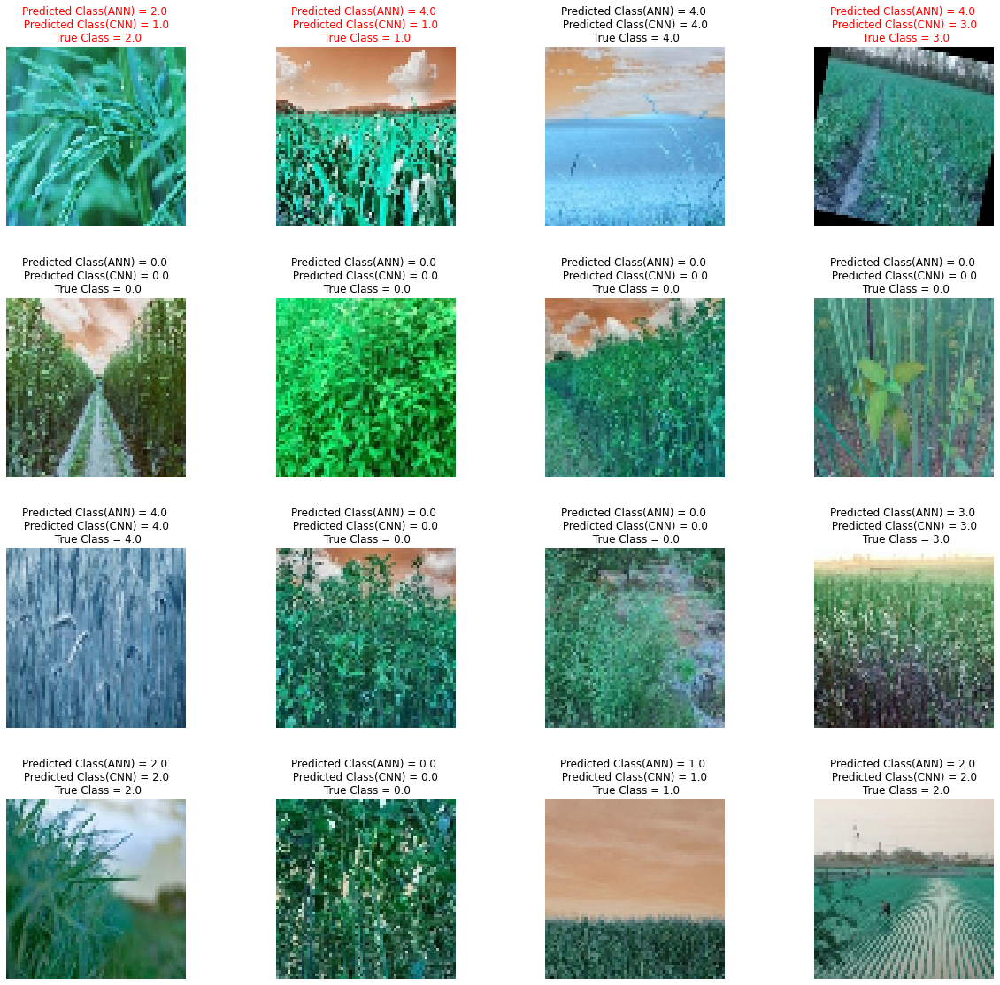

In [ ]:
# We will create a grid of images with their true label and predicted label.
l=4
w=4

fig, axes = plt.subplots(l, w, figsize=(20,20))
axes = axes.ravel()

for i in np.arange(0, l*w) :
    axes[i].imshow(valX[i].reshape(64,64,3))
    if valY[i]==predY[i] and valY[i]==predY_cnn[i]:
        axes[i].set_title('Predicted Class(ANN) = {:.1f} \n Predicted Class(CNN) = {:.1f} \n True Class = {:.1f}'.format(predY[i], predY_cnn[i], valY[i]))
    else :
        axes[i].set_title('Predicted Class(ANN) = {:.1f} \n Predicted Class(CNN) = {:.1f} \n True Class = {:.1f}'.format(predY[i], predY_cnn[i], valY[i]), color="red")
    axes[i].axis('off')

plt.subplots_adjust(wspace=0.5)

We can see that out of 16 samples, **two** samples have been missclassified by **ANN Model** and only **one** by **CNN Model**. We can say **CNN Model** is performing better job.

### **Confusion Matrix**

---



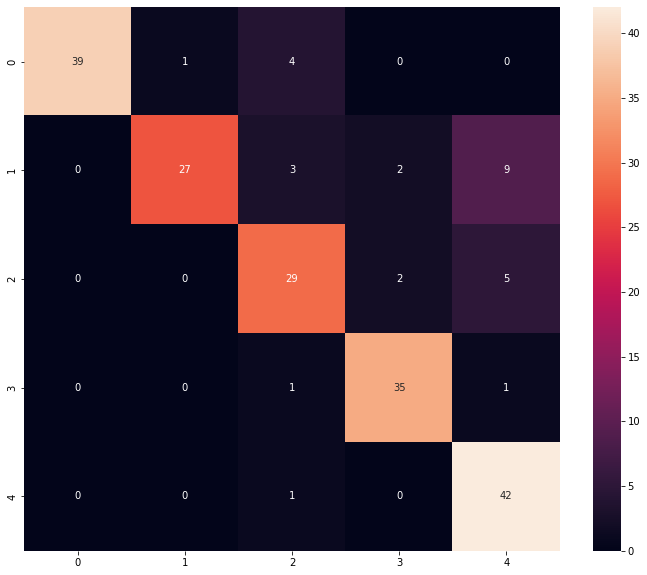

In [ ]:
# Confusion matrix for ANN

cm = confusion_matrix(valY, predY)
plt.figure(figsize=(12,10))
sns.heatmap(cm, annot=True, fmt='d')

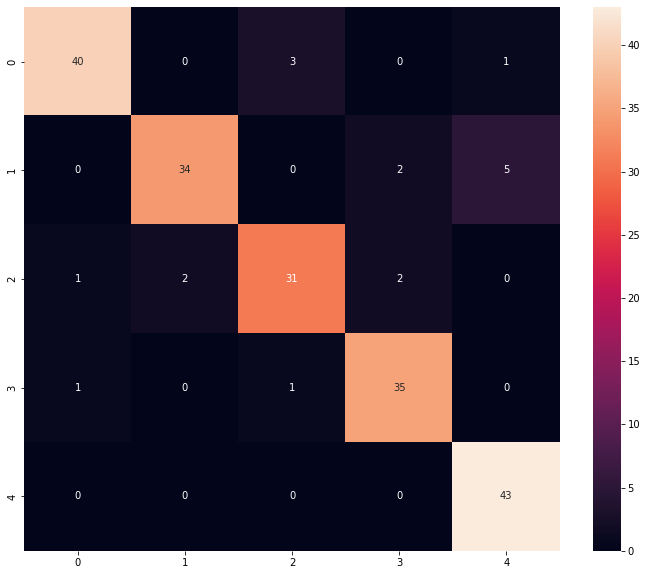

In [ ]:
# Confusion matrix for CNN

cm_cnn = confusion_matrix(valY_cnn, predY_cnn)
plt.figure(figsize=(12,10))
sns.heatmap(cm_cnn, annot=True, fmt='d')

We can see that number of misclassifications from ANN model have been reduced in CNN Model and thus CNN model is better at classifying images.

**Classification Report :**

---


In [ ]:
# Classification Report (ANN Model)
print("Classification Report of ANN")
print(classification_report(valY, predY))

Classification Report of ANN
              precision    recall  f1-score   support

           0       1.00      0.89      0.94        44
           1       0.96      0.66      0.78        41
           2       0.76      0.81      0.78        36
           3       0.90      0.95      0.92        37
           4       0.74      0.98      0.84        43

    accuracy                           0.86       201
   macro avg       0.87      0.85      0.85       201
weighted avg       0.88      0.86      0.85       201



In [ ]:
# Classification Report (CNN Model)
print("Classification Report of CNN")
print(classification_report(valY_cnn, predY_cnn))

Classification Report of CNN
              precision    recall  f1-score   support

           0       0.95      0.91      0.93        44
           1       0.94      0.83      0.88        41
           2       0.89      0.86      0.87        36
           3       0.90      0.95      0.92        37
           4       0.88      1.00      0.93        43

    accuracy                           0.91       201
   macro avg       0.91      0.91      0.91       201
weighted avg       0.91      0.91      0.91       201



It is evident that CNN model is outperforming ANN Model in all the metrics. Going with CNN Model will be better.

**Model Accuracy :**

---



---



In [ ]:
# Model Accuracy(ANN Model)
acc=accuracy_score(valY, predY)
print("The accuracy of the ANN model : {:.2f} % ".format(acc*100))

The accuracy of the ANN model : 85.57 % 


In [ ]:
# Model Accuracy(CNN Model)
acc_cnn=accuracy_score(valY_cnn, predY_cnn)
print("The accuracy of the CNN model : {:.2f} % ".format(acc_cnn*100))

The accuracy of the CNN model : 91.04 % 


CNN model has 6 % more accuracy than the ANN model.

###Accuracy and Loss Plots :
---

In [ ]:
# Plot the Training and Validation Accuracy and Loss for ANN & CNN
# N = np.arange(0,EPOCHS)
# N_cnn = np.arange(0, EPOCHS_CNN)

# plt.style.use("ggplot")
# plt.figure(figsize = [10,8])
# plt.plot(N, H2.history["accuracy"], label = "ANN_train_acc")
# plt.plot(N, H2.history["val_accuracy"], label = "ANN_val_acc")
# plt.title("ANN : Training & Validation Accuracy")
# plt.xlabel("Epoch #", weight = "bold")
# plt.ylabel("Accuracy", weight = "bold")
# plt.legend()
# plt.show()

# plt.style.use("ggplot")
# plt.figure(figsize = [10,8])
# plt.plot(N_cnn, H_cnn.history["accuracy"], label = "CNN_train_acc")
# plt.plot(N_cnn, H_cnn.history["val_accuracy"], label = "CNN_val_acc")
# plt.title("CNN : Training & Validation Accuracy")
# plt.xlabel("Epoch #", weight = "bold")
# plt.ylabel("Accuracy", weight = "bold")
# plt.legend()
# plt.show()

# plt.style.use("ggplot")
# plt.figure(figsize = [10,8])
# plt.plot(N, H2.history["loss"], label = "ANN_train_loss")
# plt.plot(N, H2.history["val_loss"], label = "ANN_val_loss")
# plt.title("ANN : Training & Validation Loss")
# plt.xlabel("Epoch #", weight = "bold")
# plt.ylabel("Loss", weight = "bold")
# plt.legend()
# plt.show()

# plt.style.use("ggplot")
# plt.figure(figsize = [10,8])
# plt.plot(N_cnn, H_cnn.history["loss"], label = "CNN_train_loss")
# plt.plot(N_cnn, H_cnn.history["val_loss"], label = "CNN_val_loss")
# plt.title("CNN : Training & Validation Loss")
# plt.xlabel("Epoch #", weight = "bold")
# plt.ylabel("Loss", weight = "bold")
# plt.legend()
# plt.show()

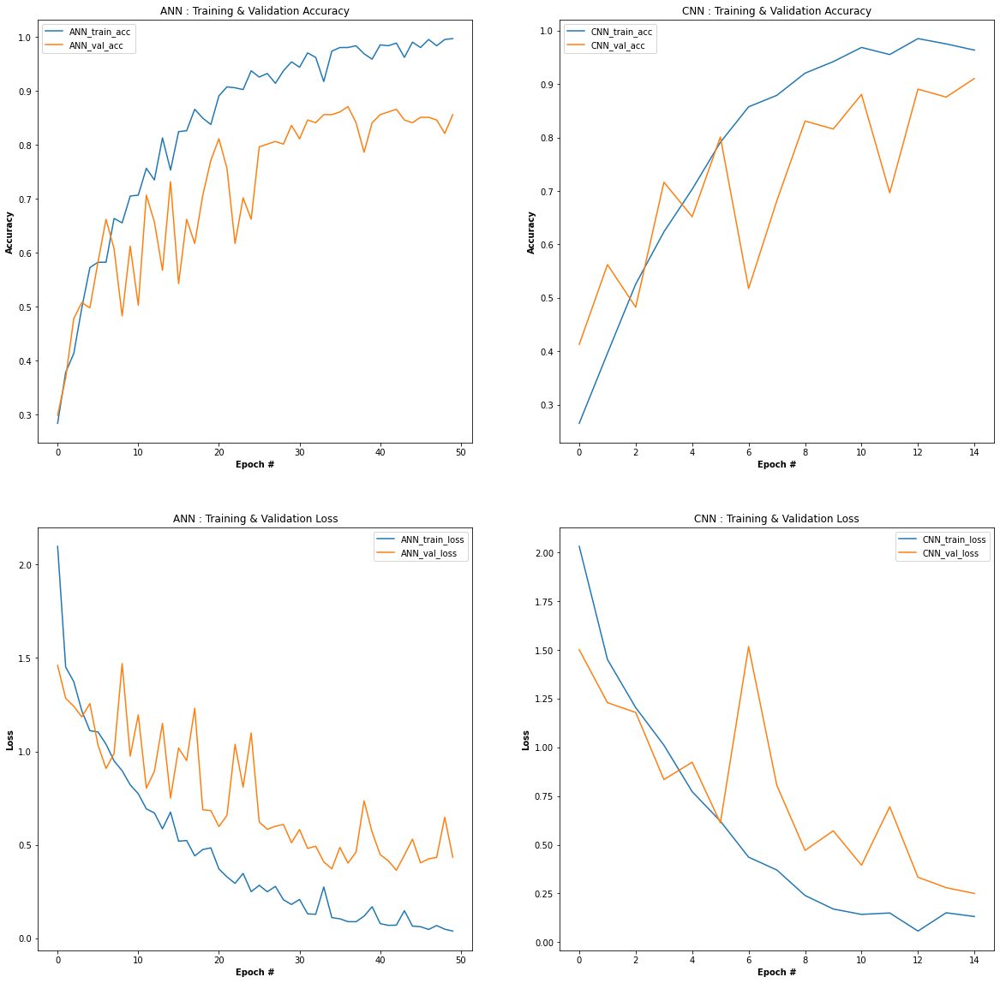

In [ ]:
# Plot the Training and Validation Accuracy and Loss for ANN & CNN
N = np.arange(0,EPOCHS)
N_cnn = np.arange(0, EPOCHS_CNN)

fig, ax = plt.subplots(2,2, figsize = [20,20])
ax = ax.ravel()

ax[0].plot(N, H2.history["accuracy"], label = "ANN_train_acc")
ax[0].plot(N, H2.history["val_accuracy"], label = "ANN_val_acc")
ax[0].set_title("ANN : Training & Validation Accuracy")
ax[0].set_xlabel("Epoch #", weight = "bold")
ax[0].set_ylabel("Accuracy", weight = "bold")
ax[0].legend()

ax[1].plot(N_cnn, H_cnn.history["accuracy"], label = "CNN_train_acc")
ax[1].plot(N_cnn, H_cnn.history["val_accuracy"], label = "CNN_val_acc")
ax[1].set_title("CNN : Training & Validation Accuracy")
ax[1].set_xlabel("Epoch #", weight = "bold")
ax[1].set_ylabel("Accuracy", weight = "bold")
ax[1].legend()

ax[2].plot(N, H2.history["loss"], label = "ANN_train_loss")
ax[2].plot(N, H2.history["val_loss"], label = "ANN_val_loss")
ax[2].set_title("ANN : Training & Validation Loss")
ax[2].set_xlabel("Epoch #", weight = "bold")
ax[2].set_ylabel("Loss", weight = "bold")
ax[2].legend()

ax[3].plot(N_cnn, H_cnn.history["loss"], label = "CNN_train_loss")
ax[3].plot(N_cnn, H_cnn.history["val_loss"], label = "CNN_val_loss")
ax[3].set_title("CNN : Training & Validation Loss")
ax[3].set_xlabel("Epoch #", weight = "bold")
ax[3].set_ylabel("Loss", weight = "bold")
ax[3].legend()

plt.subplots_adjust(wspace=0.2, hspace=0.2)

We can see that graphs of CNN Model are smoother than ANN Model, thus there are no abrupt changes in the accuracy and loss. Similarly the CNN model has achieved better balance in training and validation parameters in less number of epochs.

## Save the Trained Model (CNN)

In [ ]:
model_cnn.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 64, 64, 10)        760       
_________________________________________________________________
activation_4 (Activation)    (None, 64, 64, 10)        0         
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 32, 32, 10)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 32, 32, 20)        5020      
_________________________________________________________________
activation_5 (Activation)    (None, 32, 32, 20)        0         
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 16, 16, 20)        0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 5120)             

In [ ]:
# # Save the model to disk as h5
print("[WIP] Saving the CNN model...")
model_cnn.save('Crop_CNN.h5') # Name of the model

[WIP] Saving the CNN model...


In [ ]:
# Save the file using pickle as .pkl
# import pickle

# filename = "Crop_CNN.pkl"
# pickle.dump( model_cnn, filename, 'wb')

TypeError: ignored

## Making Predictions on Test Images using saved CNN model

We can create a seperate script or notebook and load the saved model to perform predictions. Instead we will continue in this notebook

In [ ]:
# import required packages
from tensorflow.keras.models import load_model
import pickle
import  cv2
import imutils
import matplotlib.pyplot as plt
%matplotlib inline



Load the Model

In [ ]:
# # Load the model (In this notebook we can skip this step)
# print("[WIP] Loading the model...")
# model_n = load_model("Crop_ANN.h5")

### **Display the images and display predictions**

In [ ]:
# Function to display the images 

def display_img(img):
    fig = plt.figure(figsize=(12,10))
    plt.grid(b=None)
    ax = fig.add_subplot(111)
    ax.imshow(img)

  0%|          | 0/45 [00:00<?, ?it/s]

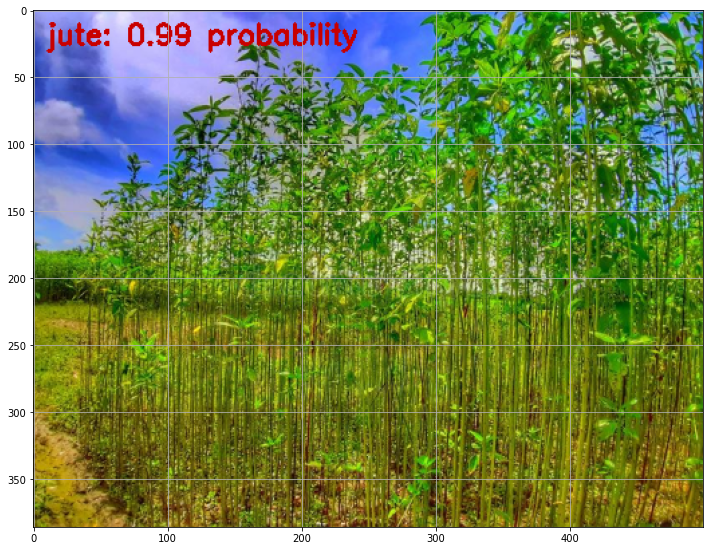

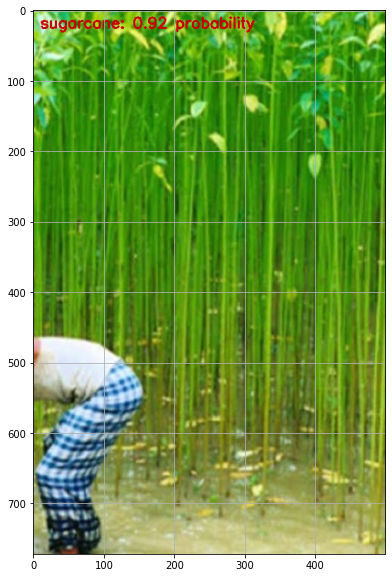

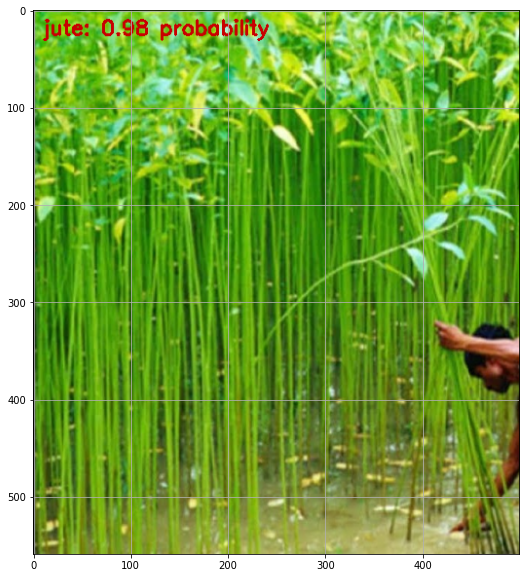

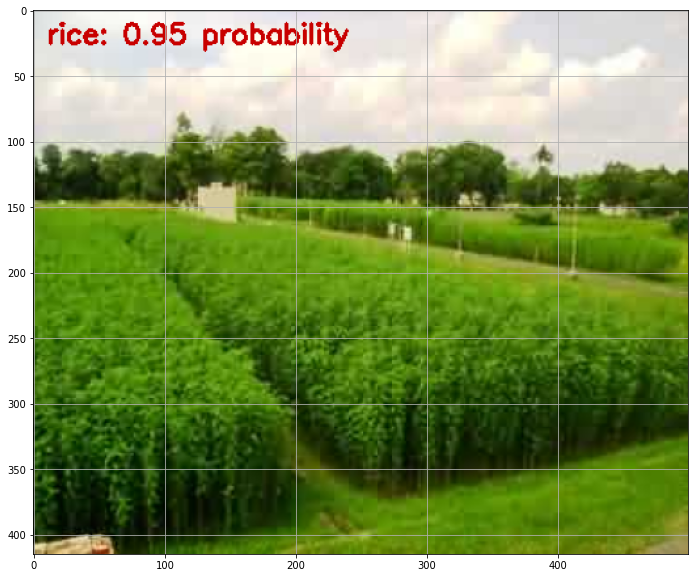

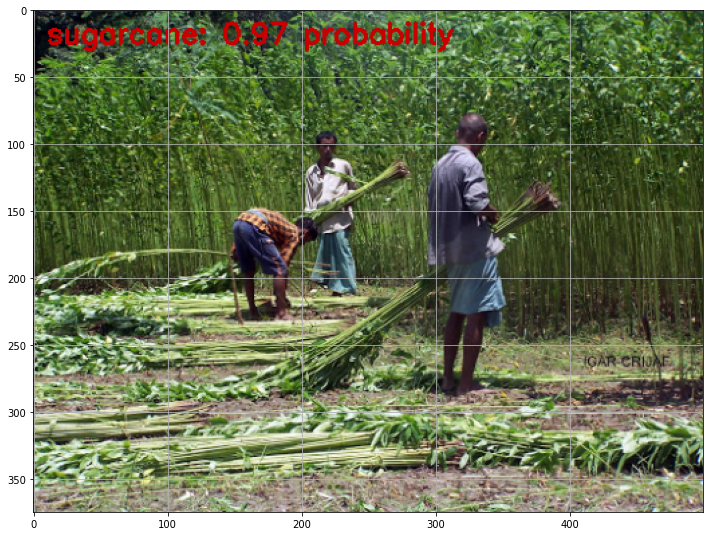

...

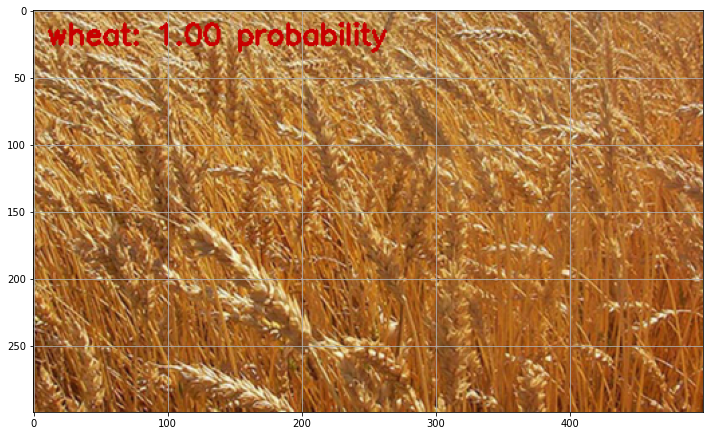

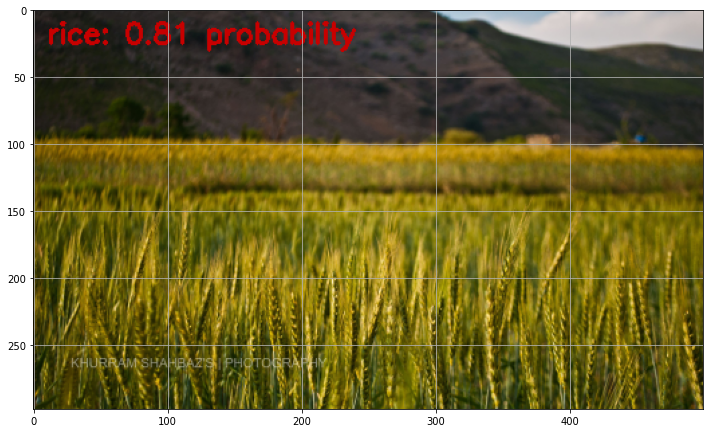

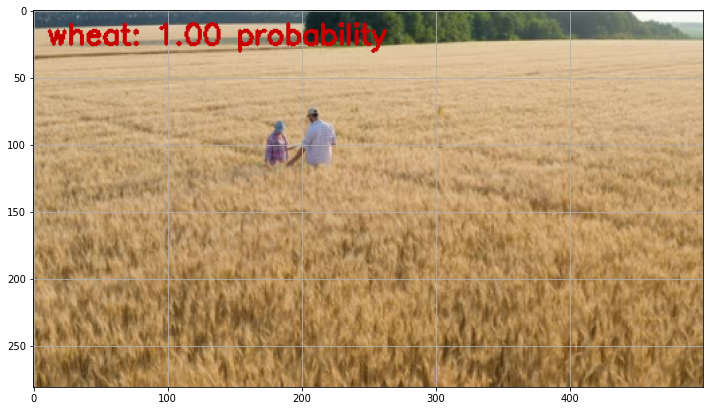

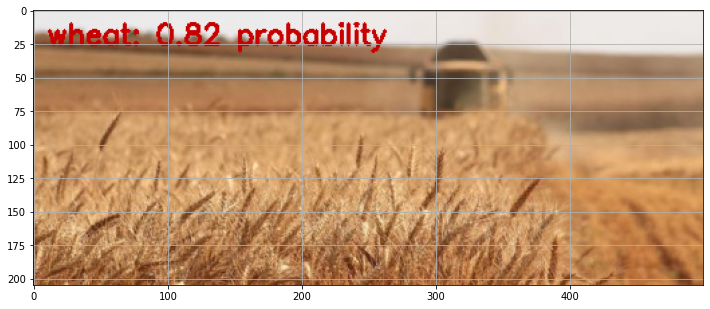

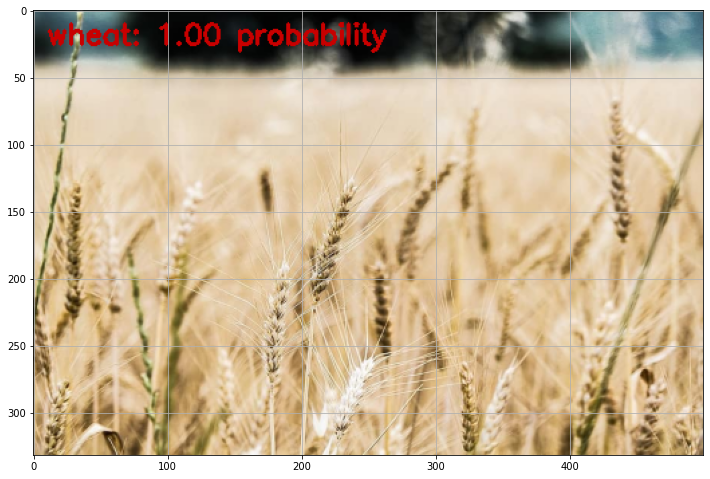

In [ ]:
# Load the input image and resize it to required dimensions

width = 64
height = 64

# Grab the image path
testImagePaths = sorted(list(paths.list_images('dataset_crop/test_crop_image')))  # Folder containing test images

# Progress Bar

with tqdm(total=len(testImagePaths)) as pbar:

    for imagePath in testImagePaths:
        image = cv2.imread(imagePath)
        output = image.copy()
        image = cv2.resize(image, (width, height))

        # Scale pixel values from range 0-255 to range 0-1
        image = image.astype("float") / 255.0

        # As input for the network 
        # image = image.flatten()  # No flatten for CNN Model
        image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))

        # make prediction on the image
        preds_proba =  model_cnn.predict(image)

        # Get the class label cooresponding to index of highest probability
        i = preds_proba.argmax(axis=1)[0]
        img_label = classes[i]

        img_label = "{}: {:.2f} probability".format(img_label, preds_proba[0][i])

        output = imutils.resize(output, width = 500)
        cv2.putText(output, img_label, (10,25), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,0,200), 2)

        # Convert the image to rgb formatand display
        img = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)
        display_img(img)

        pbar.update(1)

## **DEPLOY THE MODEL**

In [ ]:
!pip install gradio

In [ ]:
# # Import packages and model 
import gradio as gr

from tensorflow.keras.models import load_model
import pickle
import cv2
import imutils
import matplotlib.pyplot as plt
%matplotlib inline

# # Loading model
# print("[WIP] Loading the model...")
# model_n = load_model('/content/drive/MyDrive/PGAA08_DS_DL/Crop_Classification_ANN/Crop_ANN.h5')

In [ ]:
def predict_image(image):

    image = cv2.resize(image, (64,64))

    # scale values from range 0-255 to 0-1
    image = image.astype("float") / 255.0

    # Ready the image for input to the network
    image = img_to_array(image)
    image = np.expand_dims(image, axis=0)

    # make prediction on the image
    preds = model_cnn.predict(image)[0]
    result = dict()
    result[classes[0]] = round(float(list(preds)[0]), 3)
    result[classes[1]] = round(float(list(preds)[1]), 3)
    result[classes[2]] = round(float(list(preds)[2]), 3)
    result[classes[3]] = round(float(list(preds)[3]), 3)
    result[classes[4]] = round(float(list(preds)[4]), 3)
    

    return result

In [ ]:
im = gr.inputs.Image(shape= (64,64))
label = gr.outputs.Label(num_top_classes=3)

gr.Interface(fn = predict_image, inputs = im, outputs = label, capture_session=True, title = "CNN Classification of Crops").launch(share=True)

Colab notebook detected. To show errors in colab notebook, set `debug=True` in `launch()`
Running on public URL: https://23057.gradio.app

This share link expires in 72 hours. For free permanent hosting, check out Spaces (https://huggingface.co/spaces)


(<fastapi.applications.FastAPI at 0x7fdba367d690>,
 'http://127.0.0.1:7860/',
 'https://23057.gradio.app')